![title](images/header.png)


# Road Network and Travel Time Prediction from Satellite Imagery on a CPU
-----
Automated road network extraction from remote sensing imagery remains a significant challenge despite its importance in a broad array of applications. To this end, we explore road network extraction at scale with inference of semantic features of the graph, identifying speed limits and route travel times for each roadway. We call this approach City-Scale Road Extraction from Satellite Imagery (CRESI). See our [paper](http://openaccess.thecvf.com/content_WACV_2020/papers/Van_Etten_City-Scale_Road_Extraction_from_Satellite_Imagery_v2_Road_Speeds_and_WACV_2020_paper.pdf) for further details on CRESI.

Including estimates for travel time permits true optimal routing (rather than just the shortest geographic distance), which is not possible with existing remote sensing imagery based methods.  Such time-based routing is usually critical to most use cases, and can differ significantly from simple geometric routing (see figure below).

![title](images/routes.png)


This tutorial details the steps required to extract road networks starting from raw satellite imagery on a local laptop (no GPU server required).  We also explore optimized routing techniques that apply these techniques to an example evacuation scenario in a previously unseen city.

This notebook (Part 2) demonstrates the CRESI algorithm, and assumes: 

- The user has already set up the environment via [Part 1](https://github.com/CosmiQ/cresi/tree/master/notebooks/dar_tutorial_cpu/cresi_cpu_part1.ipynb).
- Docker has 6+ GB of Memory and 6+ CPU cores available (edited via the  Preferencees -> Resources menu).
- The local CRESI directory (```cresi_dir``` in Part 1) is mounted in ```/opt/cresi/``` in the docker container.  
- This notebook is using the docker kernel and is accessed via: http://localhost:9111/notebooks/cresi_cpu_part2.ipynb.

In [9]:
# import packages within the docker kernel

import os
import json
import skimage.io
import osmnx as ox
import numpy as np
import pandas as pd
import scipy.spatial
import networkx as nx
import matplotlib.pyplot as plt

cresi_dir = '/opt/cresi'
src_dir = os.path.join(cresi_dir, 'cresi')
config_dir = os.path.join(cresi_dir, 'cresi/configs')
weight_dir = os.path.join(cresi_dir, 'results/aws_weights')
test_im_raw_dir = os.path.join(cresi_dir, 'test_imagery/dar/PS-MS')
test_im_clip_dir = os.path.join(cresi_dir, 'test_imagery/dar/PS-MS_clip')
test_final_dir = os.path.join(cresi_dir, 'test_imagery/dar/PS-RGB_8bit_clip')
results_root_dir = os.path.join(cresi_dir, 'results')
results_dir = os.path.join(results_root_dir, 'dar_tutorial_cpu')
mask_pred_dir = os.path.join(results_dir, 'folds')
mask_stitched_dir = os.path.join(results_dir, 'stitched/mask_norm')
# make dirs
for d in [weight_dir, test_im_raw_dir, test_im_clip_dir, test_final_dir]:
    os.makedirs(d, exist_ok=True)

-----
## 2. Download Data

### A. Model Weights

CRESI provided the algorithmic baseline for the [SpaceNet 5 Challenge](https://spacenet.ai/sn5-challenge/).  While challenge participants managed to improve the perforamnce of the CRESI baseline by about 5%, we will use the original CRESI model for this exercise, as it has by far the fastest runtime (see [this blog](https://medium.com/the-downlinq/spacenet-5-winning-model-release-end-of-the-road-fd02e00b826c) for further details.) Model weights are freely available on AWS.  The [AWS CLI](https://aws.amazon.com/cli/) tool is installed within the docker container, so you once you configure this tool (via ```aws configure```), simply execute the cell below:

In [ ]:
!aws s3 cp --recursive s3://spacenet-dataset/spacenet-model-weights/spacenet-5/baseline/ {weight_dir}

### B. Testing Data

Since the pre-trained model weights are available, we need not download the SpaceNet training data.  Instead, we will just download the testing data.  For this exercise, we'll explore SpaceNet Area of Interest (AOI) \#10: Dar Es Salaam.  This city was withheld for testing purposes in SpaceNet 5, meaning that the pre-trained model has not been trained on this city whatsoever.  To download the data (25 GB):

In [ ]:
!aws s3 cp --recursive s3://spacenet-dataset/AOIs/AOI_10_Dar_Es_Salaam/PS-MS/ {test_im_raw_dir}

-----
## 3. Prepare Test Data

While CRESI is designed to handle images of arbitrary size and extent, for this exercise we will clip the image somewhat to speed processing time and ease visualization. We will also convert the 8-band multispectral 16-bit image to an easier to visualize 8-bit RGB image. 

In [2]:
# Clip the image extent
ulx, uly, lrx, lry = 39.25252, -6.7580, 39.28430, -6.7880  # v0

im_name = [z for z in os.listdir(test_im_raw_dir) if z.endswith('.tif')][0]
print("im_name:", im_name)
test_im_raw = os.path.join(test_im_raw_dir, im_name)
test_im_clip = os.path.join(test_im_clip_dir, im_name.split('.tif')[0] + '_clip.tif')
print("output_file:", test_im_clip)

!gdal_translate -projwin {ulx} {uly} {lrx} {lry} {test_im_raw} {test_im_clip}

im_name: AOI_10_Dar_Es_Salaam_PS-MS_COG.tif
output_file: /opt/cresi/test_imagery/dar/PS-MS_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
Input file size is 51038, 48420
0...10...20...30...40...50...60...70...80...90...100 - done.


/opt/cresi/cresi/data_prep
im_files: ['AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif']
bmin, bmax: 1 1960
zero_frac =  0.0
bmin, bmax: 1 1744
zero_frac =  0.0
bmin, bmax: 1 1820
zero_frac =  0.0
Conversion_command list: ['gdal_translate', '-ot', 'Byte', '-of', 'GTiff', '-a_nodata', '0', '-co', '"PHOTOMETRIC=rgb"', '-b 5', '-scale_1', '75.0', '702.0', '0', '255', '-b 3', '-scale_2', '87.0', '556.0', '0', '255', '-b 2', '-scale_3', '65.0', '470.0', '0', '255', '/opt/cresi/test_imagery/dar/PS-MS_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif', '/opt/cresi/test_imagery/dar/PS-RGB_8bit_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif']
Conversion_command str: gdal_translate -ot Byte -of GTiff -a_nodata 0 -co "PHOTOMETRIC=rgb" -b 5 -scale_1 75.0 702.0 0 255 -b 3 -scale_2 87.0 556.0 0 255 -b 2 -scale_3 65.0 470.0 0 255 /opt/cresi/test_imagery/dar/PS-MS_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif /opt/cresi/test_imagery/dar/PS-RGB_8bit_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif


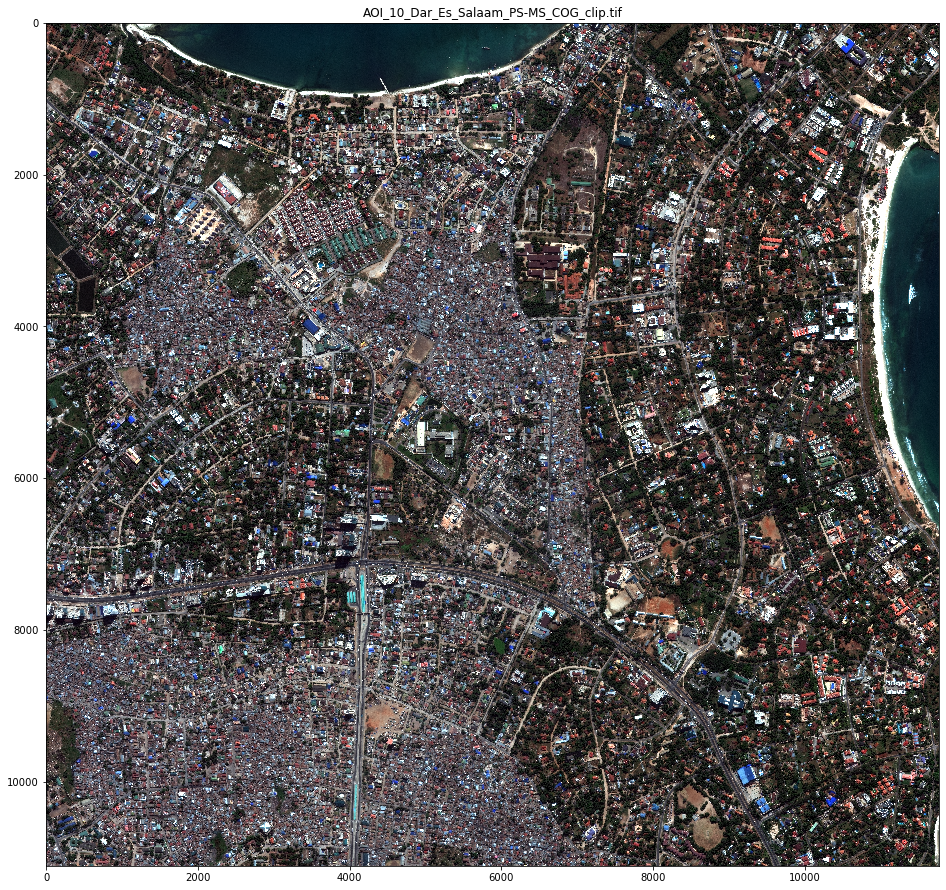

In [3]:
# Convert 16-bit multispectral test data to 8-bit RGB
%cd {os.path.join(cresi_dir, 'cresi/data_prep/')}
import create_8bit_images

create_8bit_images.dir_to_8bit(test_im_clip_dir, test_final_dir,
                              command_file_loc='',
                              rescale_type="perc",
                              percentiles=[2,98],
                              band_order=[5,3,2])

# display our test image
fig_width, fig_height = 16, 16
im_test_name = [z for z in os.listdir(test_final_dir) if z.endswith('.tif')][0]
im_test_path = os.path.join(test_final_dir, im_test_name)
im_test = skimage.io.imread(im_test_path)

fig, ax = plt.subplots(figsize=(fig_width, fig_height))
_ = ax.imshow(im_test)
_ = ax.set_title(im_test_name)

Image stats for AOI_10_Dar_Es_Salaam_PS-RGB_COG_clip.tif: 
- Image shape = (11770, 11111, 3) 
- Num pixels = 130,776,470
- Area = 11.7 km2

-----
## 4. Prepare the config file

CRESI reads from a .json configuration file, and for a pre-trained model executing inference requires only changing a few paths (namely, the testing imagery, model weights, and results paths) in the ```cresi/cresi/configs/dar_tutorial_cpu.json``` file.  These paths should already be set properly, but if not, exectue the cell below.

In [10]:
config_path = os.path.join(config_dir, 'dar_tutorial_cpu.json')
print("config path:", config_path)

# update directories
with open(config_path, 'r+') as f:
    data = json.load(f)
    data['path_src'] = src_dir
    data['path_results_root'] = results_root_dir
    data['speed_conversion_file'] = os.path.join(config_dir, 'speed_conversion_binned7.csv')
    data['save_weights_dir'] = os.path.join(weight_dir, 'weights') 
    data['test_data_refined_dir'] = test_final_dir
    data['test_sliced_dir'] = test_final_dir + '_sliced'
    data['test_results_dir'] = 'dar_tutorial_cpu'
# write new values
os.remove(config_path)
with open(config_path, 'w') as f:
    json.dump(data, f, indent=4)

print("config data:")
data

config path: /opt/cresi/cresi/configs/dar_tutorial_cpu.json
config data:


{'path_src': '/opt/cresi/cresi',
 'path_results_root': '/opt/cresi/results',
 'speed_conversion_file': '/opt/cresi/cresi/configs/speed_conversion_binned7.csv',
 'save_weights_dir': '/opt/cresi/results/aws_weights/weights',
 'test_data_refined_dir': '/opt/cresi/test_imagery/dar/PS-RGB_8bit_clip',
 'test_sliced_dir': '/opt/cresi/test_imagery/dar/PS-RGB_8bit_clip_sliced',
 'test_results_dir': 'dar_tutorial_cpu',
 'slice_x': 1300,
 'slice_y': 1300,
 'stride_x': 1280,
 'stride_y': 1280,
 'skeleton_thresh': 0.25,
 'min_subgraph_length_pix': 600,
 'min_spur_length_m': 12,
 'rdp_epsilon': 1,
 'log_to_console': 0,
 'train_data_refined_dir_ims': '',
 'train_data_refined_dir_masks': '',
 'folds_file_name': 'folds4.csv',
 'folds_save_dir': 'folds',
 'tile_df_csv': 'tile_df.csv',
 'merged_dir': 'merged',
 'stitched_dir_raw': 'stitched/mask_raw',
 'stitched_dir_count': 'stitched/mask_count',
 'stitched_dir_norm': 'stitched/mask_norm',
 'wkt_submission': 'wkt_submission_nospeed.csv',
 'skeleton_dir':

-----
## 5. Run Inference

The simplest option is to sipmly run the test.sh script (e.g. ```./test.sh configs/dar_tutorial_cpu.json```) which will execute all of the various inference scipts in series.  For this exercise, we will instead run the individual commands to view what's going on at each step.

### 5.1. 02_eval.py 

The 02_eval.py script applies the trained deep learning model to our testing imagery.  First, we tile the imagery into manageable sizes (~400 x 400 meters or 1300 x 1300 pixels), since the entire 130 million pixel image will far exceed available memory on non-supercomputers.  On a MacBook Pro inference proceeds at ~14 seconds per tile, and the entire process completes in ~15 minutes for our 12 square kilometer test image.  For reference, running inference on a single Titan X GPU is 20X faster and completes in ~1 minute.

While running, you will see a progress bar something like:
```
 48%|████▊     | 43/90 [07:19<07:58, 10.19s/it]
```

We will kick off inference, and while it's running we'll skip to the intermission and dive deeper into why our approach is necessary.

In [7]:
%cd {src_dir}
%run -i 02_eval.py configs/dar_tutorial_cpu.json

/opt/cresi/cresi
Executing inference on the CPU
Run utils.update_config()...
Updated config: OrderedDict([('path_src', '/opt/cresi/cresi'), ('path_results_root', '/opt/cresi/results/dar_tutorial_cpu'), ('save_weights_dir', '/opt/cresi/results/aws_weights/weights'), ('num_channels', 3), ('network', 'resnet34'), ('skeleton_thresh', 0.25), ('use_medial_axis', 0), ('min_subgraph_length_pix', 600), ('min_spur_length_m', 12), ('rdp_epsilon', 1), ('skeleton_band', 7), ('intersection_band', -1), ('early_stopper_patience', 5), ('num_folds', 1), ('default_val_perc', 0.2), ('train_data_refined_dir_ims', ''), ('train_data_refined_dir_masks', ''), ('speed_conversion_file', '/opt/cresi/cresi/configs/speed_conversion_binned7.csv'), ('folds_file_name', 'folds4.csv'), ('test_data_refined_dir', '/opt/cresi/test_imagery/dar/PS-RGB_8bit_clip'), ('test_results_dir', 'dar_tutorial_cpu'), ('test_sliced_dir', '/opt/cresi/test_imagery/dar/PS-RGB_8bit_clip_sliced'), ('slice_x', 1300), ('slice_y', 1300), ('strid

  0%|          | 0/90 [00:00<?, ?it/s]

  model: Resnet34_upsample(
  (bottlenecks): ModuleList(
    (0): ConvBottleneck(
      (seq): Sequential(
        (0): Conv2d(512, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (1): ConvBottleneck(
      (seq): Sequential(
        (0): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (2): ConvBottleneck(
      (seq): Sequential(
        (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
    (3): ConvBottleneck(
      (seq): Sequential(
        (0): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU(inplace=True)
      )
    )
  )
  (decoder_stages): ModuleList(
    (0): UnetDecoderBlock(
      (layer): Sequential(
        (0): Upsample(scale_factor=2.0, mode=nearest)
        (1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (2): R

100%|██████████| 90/90 [15:04<00:00, 10.05s/it]

Time to run 1 folds for 90 = 910.5242521762848 seconds


-----
## Intermission: OSM / Commercial Products

One question that often gets asked about approaches like CRESI is: doesn't Google Mapp, Apple Maps, or OpenStreetMap (OSM) already do this? It turns out that there are a number of advantages to a computer vision centric approach, as detailed below.

Commercial products like Google/Apple certainly have a lot of value, but these products often rely upon cell phone GPS pings and infrequently updated imagery for determining real-time routing; in a dynamic scenario (e.g.: natural disaster) existing road networks may be out of date, and cell towers may be down.  Furthermore, the underlaying data is proprietary, further complicating use by practitioners.

Open source offerings such as OSM are similarly useful, though also have limitations.  The crowd-sourced nature of OSM means that updates can take significant time to re-map areas.  For example, it took the Humanitarian OpenStreetMap Team (HOT) over [two months](https://wiki.openstreetmap.org/wiki/2017_Hurricanes_Irma_and_Maria) to fully map Puerto Rico after Hurricane Maria in 2017, even with thousands of volunteers.  

Furthermore, OSM road metadata that can be used to optimize routing is often missing, and road centerline label quality is inconsistent.  For example in the image below there are missing roads on the left, and roads that go through buildings on the right.
<img src="images/osm_goofs.jpg" alt="Drawing" style="height: 200px;"/>

The label inconsistency was explored in Table 3 of our [CRESI paper](http://openaccess.thecvf.com/content_WACV_2020/papers/Van_Etten_City-Scale_Road_Extraction_from_Satellite_Imagery_v2_Road_Speeds_and_WACV_2020_paper.pdf), where we noted significantly reduced road inference performance when using OSM labels versus SpaceNet labels.  

As an example of the sparsity of OSM metadata, we pulled the OSM map for a portion of one of our training cities (Shanghai) below, and colored by the 'maxspeed' tag.  The vast majority of roads have no indicated speed limit.

<br>
<img src="images/shanghai_osm_speed.png" alt="Drawing" style="height: 500px;"/>
<br>

The point here is not to cast aspersions at OSM, which is a great resource, but to point out that there is a need for a rapid machine learning algorithm that can extract precise road centerlines and attendant metadata such as safe travel speed.  

The development of CRESI and administration of the [SpaceNet 5 Challege](https://spacenet.ai/sn5-challenge/) yielded a great many insights into both dataset requirements (e.g. SpaceNet + OSM, varying geographies), as well as algorithmic performance and robustness.  For further analysis of these insights we encourage readers to explore the following blogs:

1. [OSM+Google Imagery](https://medium.com/the-downlinq/computer-vision-with-openstreetmap-and-spacenet-a-comparison-cc70353d0ace)
2. [Neighborhood Comparisons](https://medium.com/the-downlinq/spacenet-5-results-deep-dive-part-2-apls-to-apls-2b1fc7307629)
3. [Predictive Features](https://medium.com/the-downlinq/spacenet-5-results-deep-dive-part-3-the-apls-sauce-378ca0666ca9)
4. [SpaceNet 5 Speed / Performance Comparision](https://medium.com/the-downlinq/spacenet-5-winning-model-release-end-of-the-road-fd02e00b826c)


-----
### 5.1. 02_eval.py (continued)

The 02_eval.py script produce a multi-channel road masks for each image tile.  Each channel of this mask corresponds to a unique speed range.  For each of the testing tiles, the predicted mask will look something like the plot below.

mask_pred.shape: (8, 1300, 1300)


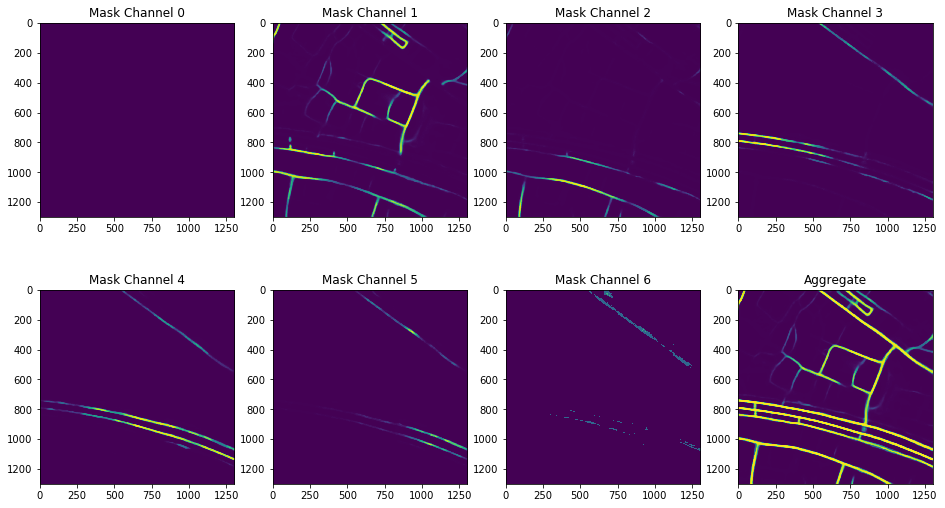

In [11]:
# inspect
mask_pred_file = 'fold0_0__AOI_10_Dar_Es_Salaam_PS-MS_COG_clip__5120__6400__1300__1300__11770__11111.tif'
mask_pred_path = os.path.join(mask_pred_dir, mask_pred_file)
mask_pred = skimage.io.imread(mask_pred_path)
print("mask_pred.shape:", mask_pred.shape)

# plot all layers
fig, axes = plt.subplots(2, 4, figsize=(16, 9))
for i, ax in enumerate(axes.flatten()):
    if i < (len(axes.flatten()) - 1):
        title = 'Mask Channel {}'.format(str(i))
    else:
        title = 'Aggregate' 
    ax.imshow(mask_pred[i,:,:])
    ax.set_title(title)

-----
### 5.2. 03b_stitch.py

The output of 02_eval.py is a series of chipped prediction masks, which we stitch back together (using the procedure illustrated below) in order to produce the aggregate prediction mask.  

<br>
<img src="images/basiss_test.jpg" alt="Drawing" style="height: 500px;"/>
<br>

The command below takes ~20 seconds to run for our test image, and creates the total mask. Many road extraction algorithms end here once a road pixel mask has been produced.  We still have a few more steps to go, however.

In [12]:
%cd {src_dir}
%run -i 03b_stitch.py configs/dar_tutorial_cpu.json

/opt/cresi/cresi
Running stitch.py...
post_process_image - w, h: 11770 11111
0 / 90
50 / 90
Compute overlay count mask...
Compute normalized mask...
  row 0 / 11111
  row 1000 / 11111
  row 2000 / 11111
  row 3000 / 11111
  row 4000 / 11111
  row 5000 / 11111
  row 6000 / 11111
  row 7000 / 11111
  row 8000 / 11111
  row 9000 / 11111
  row 10000 / 11111
  row 11000 / 11111
mask_norm.dtype: uint8
mask_raw.dtype: uint16
overlay_count.dtype: uint8
np.max(overlay_count): 4
np.min(overlay_count): 1
Saving to files...
mask_norm.shape: (8, 11111, 11770)
mask_norm.dtype: uint8
Time to run stitch.py and create large masks (and save): 23.873270988464355 seconds


mask_pred.shape: (8, 11111, 11770)


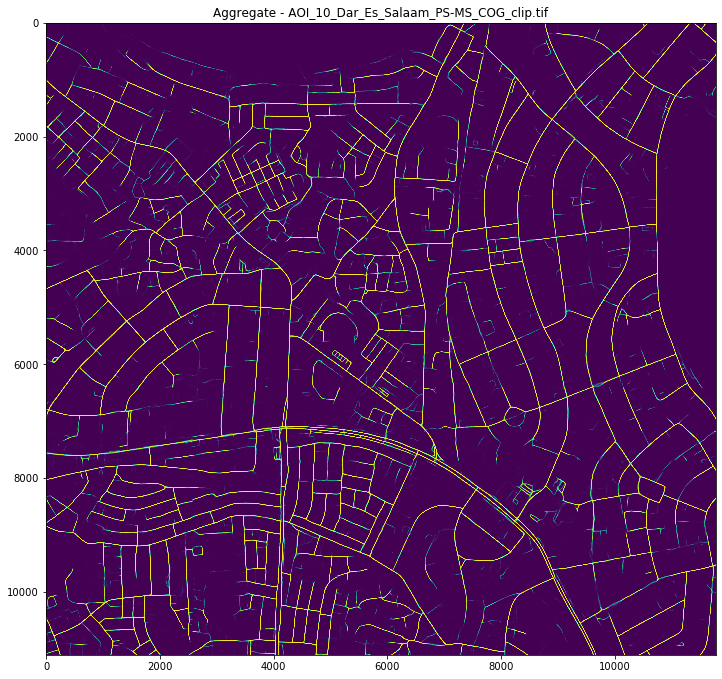

In [13]:
# Inspect the output
plot_all_layers = False
mask_pred_file = [z for z in os.listdir(mask_stitched_dir) if z.endswith('.tif')][0]
mask_pred_path = os.path.join(mask_stitched_dir, mask_pred_file)
mask_pred = skimage.io.imread(mask_pred_path)
print("mask_pred.shape:", mask_pred.shape)

# plot final layer
fig_width, fig_height = 12, 12
fig, ax = plt.subplots(figsize=(fig_width, fig_height))
_ = ax.imshow(mask_pred[-1,:,:])
_ = ax.set_title('Aggregate - ' + mask_pred_file)

# plot all layers (optional)
if plot_all_layers:
    fig, axes = plt.subplots(2, 4, figsize=(20, 11))
    for i, ax in enumerate(axes.flatten()):
        if i < (len(axes.flatten()) - 1):
            title = 'Mask Channel {}'.format(str(i))
        else:
            title = 'Aggregate' 
        ax.imshow(mask_pred[i,:,:])
        ax.set_title(title)

-----
### 5.3. 04_skeletonize.py

The 04_skeletonize script creates a graph from the aggregate mask via a multi-step process:
    
1. Refine aggregate mask via smoothing, openings, and closings.

2. Extract a skeleton of the refined mask.

3. Build a graph from the skeleton.  

Steps 1-3 are summarized in the figure below:

<br>
<img src="images/skeletonize.png" alt="Drawing" style="height: 180px;"/>
<br>

4. Clean out spurious edges and complete missing connections.

5. Output a csv of graph edges.  This csv output is included as a convenient intermediate step, since if speeds and geographic coordinates are not required we can forego Sections 5.4 and 5.5.

The 04_skeletonize.py script is multi-threaded to improve speed, and should take ~20 seconds to run.

In [14]:
%run -i 04_skeletonize.py configs/dar_tutorial_cpu.json

min_spur_length_pix: 40
Use_medial_axis? False
im_dir: /opt/cresi/results/dar_tutorial_cpu/stitched/mask_norm
out_ske_dir: /opt/cresi/results/dar_tutorial_cpu/skeleton
out_gdir: /opt/cresi/results/dar_tutorial_cpu/sknw_gpickle

 1 / 1 : AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
  img_loc: /opt/cresi/results/dar_tutorial_cpu/stitched/mask_norm/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
  im_root: AOI_10_Dar_Es_Salaam_PS-MS_COG_clip
  out_ske_file: /opt/cresi/results/dar_tutorial_cpu/skeleton/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
Executing make_skeleton...
make_skeleton(), input img_shape: ()
make_skeleton(), img.shape: (11111, 11770)
make_skeleton(), img.size: 130776470
make_skeleton(), img dtype: uint8
Run preprocess()...
Time to run preprocess(): 3.728534698486328 seconds
skeletonize...
Time to run skimage.skeletonize(): 7.3607237339019775 seconds
fix_borders...
Time fix borders: 0.056494951248168945 seconds
ske.shape: (11111, 11770)
Time to run make_skeleton: 14.209116220474243 seconds


In [15]:
# inspect the output
csv_path = os.path.join(results_dir, 'wkt_submission_nospeed.csv')
df = pd.read_csv(csv_path)
df.head()

,ImageId,WKT_Pix
0,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (7350.0 2.0, 7322.0 53.0, 7290.0 12..."
1,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (7568.0 2.0, 7558.0 16.0, 7356.0 17..."
2,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (7787.0 2.0, 7771.0 174.0, 7733.0 3..."
3,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (8759.0 2.0, 8800.0 177.0, 8835.0 2..."
4,AOI_10_Dar_Es_Salaam_PS-MS_COG_clip,"LINESTRING (10481.0 2.0, 10496.0 29.0, 10510.0..."


-----
### 5.4. 05_wkt_to_G.py

This script reads the csv output by 04_skeletonize.py back into graph format (which is very quick), and then uses the metadata encoded in our geotiff test image to assign geographic coordinates to the graph.  Assigning geo-coordinates for thousands of nodes is a computationally intensive process, so this script is multi-threaded to improve performance. The script outputs a [NetworkX](https://networkx.github.io) graph structure in ~60 seconds.

In [16]:
%run -i 05_wkt_to_G.py configs/dar_tutorial_cpu.json

image_ids: ['AOI_10_Dar_Es_Salaam_PS-MS_COG_clip']
len image_ids: 1
image_file: /opt/cresi/test_imagery/dar/PS-RGB_8bit_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
  wkt_list[:2] ['LINESTRING (7350.0 2.0, 7322.0 53.0, 7290.0 128.0, 7283.0 135.0)'
 'LINESTRING (7568.0 2.0, 7558.0 16.0, 7356.0 171.0)']
im_file: /opt/cresi/test_imagery/dar/PS-RGB_8bit_clip/AOI_10_Dar_Es_Salaam_PS-MS_COG_clip.tif
Running wkt_list_to_nodes_edges()...
Time to run wkt_list_to_nodes_egdes(): 0.553682804107666 seconds
Creating G...
  len(G.nodes(): 7490
  len(G.edges(): 7507
Time to run nodes_edges_to_G(): 0.5424449443817139 seconds
Clean out short subgraphs
Running clean_sub_graphs...
  sub_graph node count: [6316, 37, 14, 2, 3, 3, 12, 13, 6, 3, 2, 4, 5, 3, 3, 13, 8, 5, 2, 5, 5, 4, 3, 2, 9, 3, 4, 4, 3, 12, 4, 4, 4, 3, 4, 2, 4, 2, 10, 6, 2, 2, 4, 5, 5, 2, 3, 5, 8, 6, 2, 3, 3, 2, 3, 50, 4, 2, 3, 10, 3, 4, 3, 3, 4, 3, 12, 15, 3, 9, 8, 3, 5, 6, 2, 3, 3, 5, 2, 2, 5, 3, 8, 9, 5, 3, 3, 3, 3, 2, 7, 4, 3, 2, 3, 13, 41

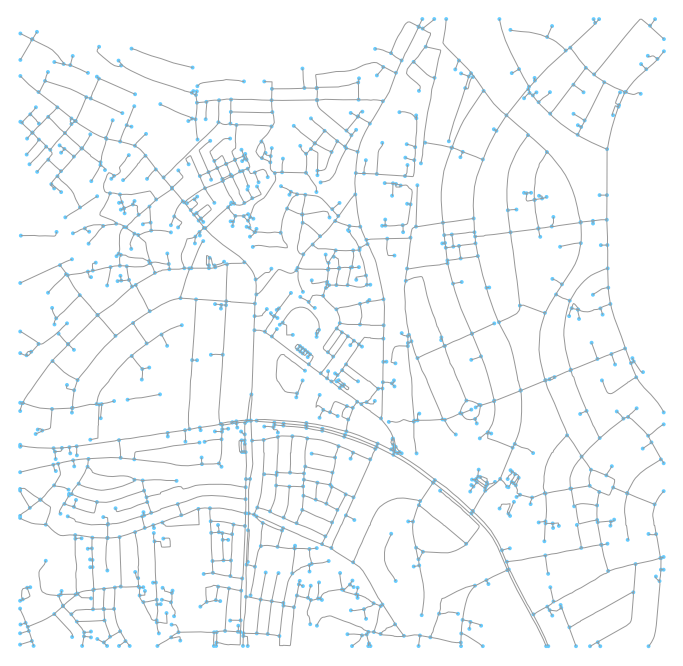

In [31]:
# inspect the output
gpickle_file = [z for z in os.listdir(os.path.join(results_dir, 'graphs')) if z.endswith('.gpickle')][0]
gpickle_path = os.path.join(results_dir, 'graphs', gpickle_file)
G0 = nx.read_gpickle(gpickle_path)
_, _ = ox.plot_graph(G0, fig_height=12, fig_width=12)

-----
### 5.5. 06_infer_speed.py

We use information encoded in the multi-channel prediction masks, in combination with the graph created from the previous steps, to infer road speed and travel time (see figure below).  

<br>
<img src="images/speed_fig.jpg" alt="Drawing" style="height: 500px;"/> 

*Speed estimation procedure: Left: Sample multi-class prediction mask; the speed (r) of an individual patch (red square) can be inferred by measuring the signal from each channel. Right: Computed road graph; travel time (∆t) is given by speed (r) and segment length (∆l).*

The speed inference script is rapid, taking only ~10 seconds for our test case.

In [32]:
%run -i 06_infer_speed.py configs/dar_tutorial_cpu.json

im_root: AOI_10_Dar_Es_Salaam_PS-MS_COG_clip
Time to infer speed: 10.283329486846924 seconds
Total time: 10.362961292266846 seconds


-----
# Results

With the graph now completed, let us explore our road network predictions in greater detail.  

In the plot below we'll plot the inferred road network, coloring by inferred road speed, with speed increasing from yellow (15 mph) to red (65 mph).

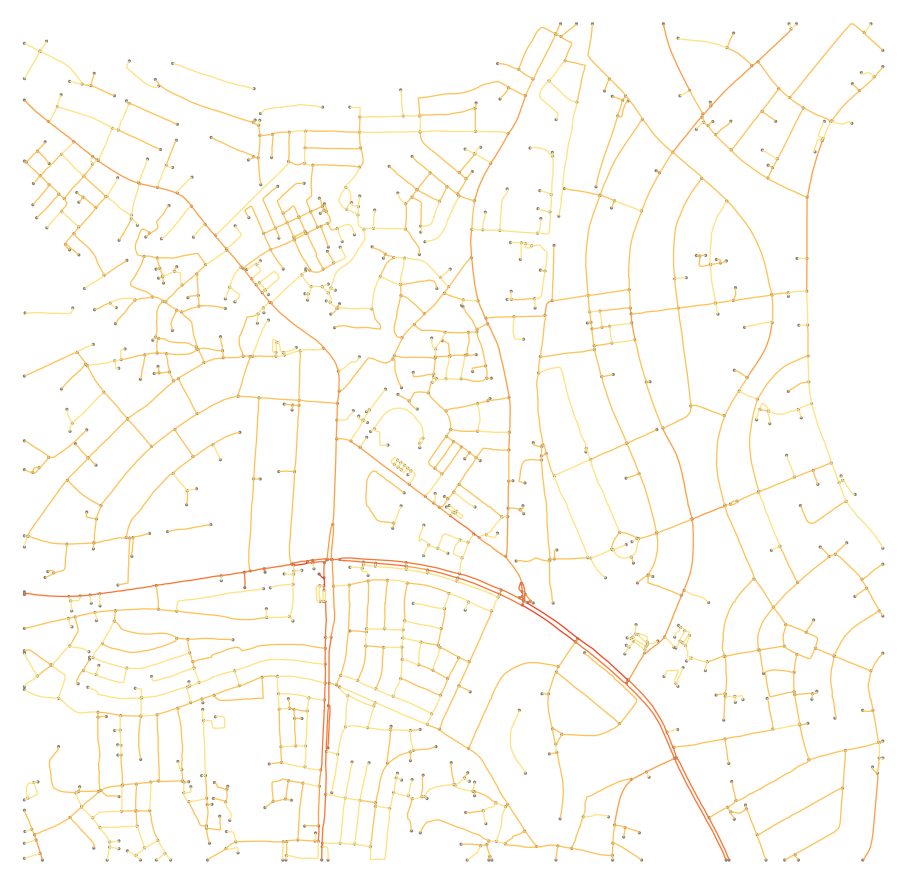

In [46]:
# Plot output graph, colored by speed
plot_graph_plus_im = __import__('08_plot_graph_plus_im')

# data
im_test = [z for z in os.listdir(test_final_dir) if z.endswith('.tif')][0]
im_test_path = os.path.join(test_final_dir, im_test)
im_test = skimage.io.imread(im_test_path).astype(np.uint8)

gpickle_file = [z for z in os.listdir(os.path.join(results_dir, 'graphs_speed')) if z.endswith('.gpickle')][0]
gpickle_path = os.path.join(results_dir, 'graphs_speed', gpickle_file)
G = nx.read_gpickle(gpickle_path)

# plot settings
fig_height=16
fig_width=16
node_color='gray'   
edge_color='#bfefff'   # lightblue
node_size=10
node_alpha=1
edge_color_key = 'inferred_speed_mph'
edge_linewidth=1.3
edge_alpha=1
route_color='blue'
orig_dest_node_color=('green', 'red')
orig_dest_node_alpha=0.8
route_linewidth=5*edge_linewidth
orig_dest_node_size=400
invert_yaxis = True
dpi=500
plt.close()

# # print an edge
# edge_tmp = list(G.edges())[-1]
# print (edge_tmp, "random edge props:", G.edges([edge_tmp[0], edge_tmp[1]])) #G.edge[edge_tmp[0]][edge_tmp[1]])

# plot
color_dict, color_list = plot_graph_plus_im.make_color_dict_list()
_ = plot_graph_plus_im.plot_graph_pix(G, im=None, fig_height=fig_height, fig_width=fig_width, 
                           node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                           edge_linewidth=edge_linewidth, edge_alpha=edge_alpha,
                           edge_color_key=edge_color_key, color_dict=color_dict,
                           invert_yaxis=invert_yaxis, 
                           default_dpi=dpi,
                           show=True, save=False)

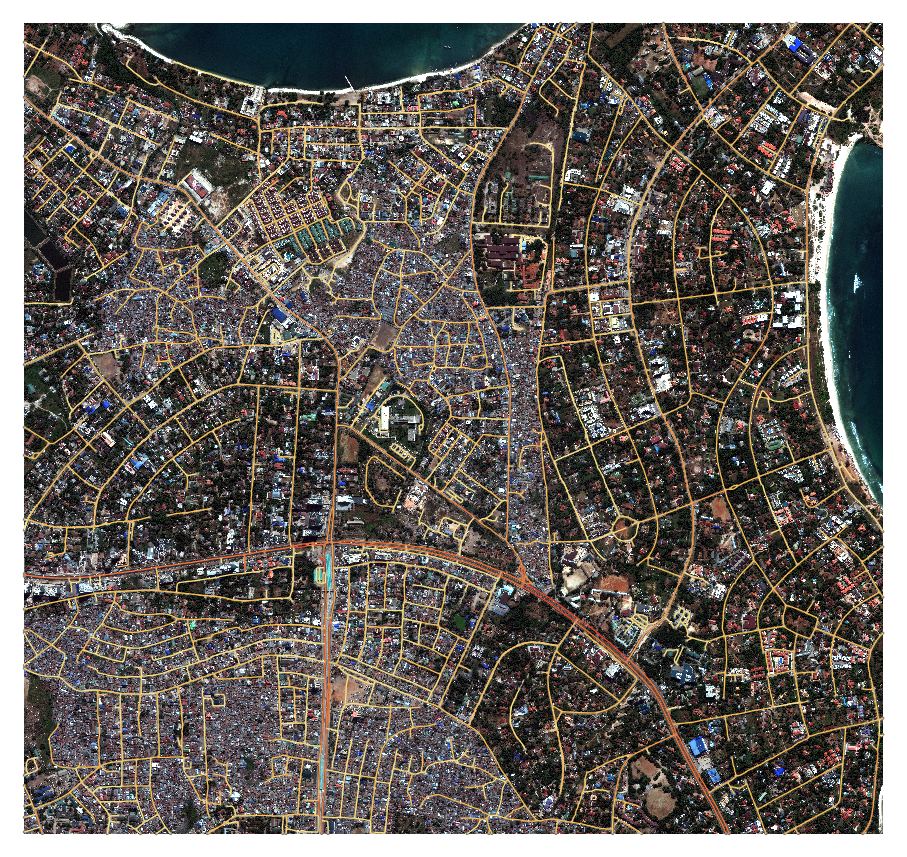

In [47]:
# We can also plot the graph with the image in the background
_ = plot_graph_plus_im.plot_graph_pix(G, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                           node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                           edge_linewidth=edge_linewidth, edge_alpha=edge_alpha,
                           edge_color_key=edge_color_key, color_dict=color_dict,
                           invert_yaxis=invert_yaxis, 
                           default_dpi=dpi,
                           show=True, save=False)

-----
## 6. Routes

We can use our final road network to compute optimal routes between nodes of interest. Furthermore, we have flexibility in how we define "optimal",  as either distance traveled or total travel time is possible.  First let's collect the node coordinates into a [kd-tree](https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.KDTree.html#scipy.spatial.KDTree) for quick nearest neighbor lookup:

In [48]:
# Get lat-lon positions of all the inferred nodes, read into a kd-tree
all_nodes = list(G.nodes())
print("N nodes:", len(all_nodes))
node_coords = np.array([[G.node[t]['lat'], G.node[t]['lon']] for t in all_nodes])
kdtree_nodes = scipy.spatial.KDTree(node_coords)
print("kdtree_nodes.data[:5]:", kdtree_nodes.data[:5])

N nodes: 1314
kdtree_nodes.data[:5]: [[-6.7580028 39.272364 ]
 [-6.7583619 39.2721831]
 [-6.7580028 39.2729526]
 [-6.7584591 39.2723802]
 [-6.7580028 39.2735439]]


Recall that our test image extends from (lat, lon) = (-6.7580, 39.25252,) to (lat, lon) = (-6.7880, 39.28430).  Let us assume a situation where we have a known asset position, and we want to evacuate to the northeast.  Let us explore this scenario:

In [49]:
asset_pos = [-6.78344, 39.26536]  # position of asset
evac_pos  = [-6.75800, 39.28430]  # northeast corner (evacuation location)

# get nodes nearest positions
n_asset = all_nodes[kdtree_nodes.query(asset_pos)[1]]
n_evac = all_nodes[kdtree_nodes.query(evac_pos)[1]]
print("start node, end node:", n_asset, n_evac)

# let's get the shortest path by distance:
weight0 = 'length'
print("\nWeight:", weight0)
length_m0, path0 = nx.single_source_dijkstra(G, source=n_asset, target=n_evac, weight=weight0)
length_km0 = length_m0 / 1000
print("path0:", path0)
print("Length0 (km):", length_km0)
# also compute time:
tt0 = sum([G[path0[i]][path0[i+1]][0]['Travel Time (h)'] for i in range(len(path0)-1)])
print("Travel Time (h)", tt0)

# Now let's weight by speed
weight1 = 'Travel Time (h)'
print("\nWeight:", weight1)
tt1, path1 = nx.single_source_dijkstra(G, source=n_asset, target=n_evac, weight=weight1)
print("path1:", path1)
length_km1 = sum([G[path1[i]][path1[i+1]][0]['length'] for i in range(len(path1)-1)])/1000
print("Length1 (km):", length_km1)
print("Travel Time (h)", tt1)

start node, end node: 16193 10024

Weight: length
path0: [16193, 16151, 15971, 16173, 16052, 15877, 15647, 15493, 15148, 15027, 14769, 14725, 14685, 14894, 14920, 14819, 14792, 14574, 14190, 14148, 13934, 13624, 13487, 13160, 12538, 12485, 12245, 12468, 12239, 11744, 11531, 11434, 11016, 10851, 10552, 10520, 10340, 10200, 10100, 10031, 10166, 10041, 10032, 10024]
Length0 (km): 4.6395324126357425
Travel Time (h) 0.10877731540417628

Weight: Travel Time (h)
path1: [16193, 16151, 15977, 15946, 15842, 15342, 14918, 14509, 14493, 14238, 13524, 13407, 13202, 13166, 12888, 12814, 12618, 12418, 12428, 12549, 12583, 12579, 12423, 12485, 12245, 12468, 12239, 11744, 11531, 11434, 11016, 10851, 10552, 10520, 10340, 10200, 10100, 10031, 10166, 10041, 10032, 10024]
Length1 (km): 4.678192348310912
Travel Time (h) 0.10604742062754784


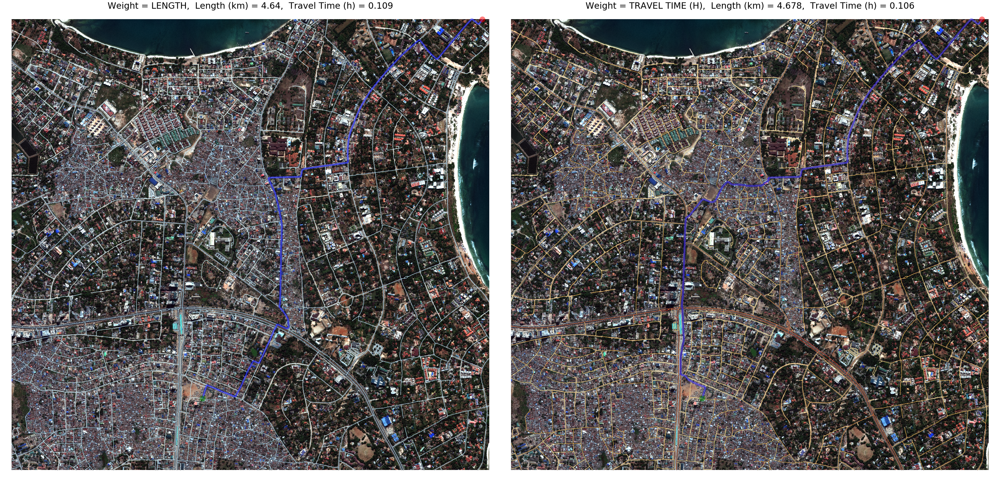

In [41]:
# Make plots...
rowplot = True
plt.close()
if rowplot:
    # side by side (easier to compare)
    fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(2*fig_width, fig_height))  
else:
    # vertically aligned (larger)
    fig, (ax0, ax1) = plt.subplots(nrows=2, figsize=(fig_width, 2.1*fig_height))  

# plot length
fout = os.path.join(results_dir, 'plots/route0_length.png')  # saving is slow...
fig, ax0 = plot_graph_plus_im.plot_graph_route_pix(G, path0, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                      node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                      edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
                      orig_dest_node_size=orig_dest_node_size,
                      route_color=route_color, 
                      orig_dest_node_color=orig_dest_node_color,
                      route_linewidth=route_linewidth,
                      invert_yaxis=invert_yaxis, 
                      default_dpi=dpi,                        
                      show=False, close=False,
                      edge_color_key=None, color_dict=None,
                      save=False, filename=fout,
                      fig=fig, ax=ax0)
_ = ax0.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
    weight0.upper(), np.round(length_km0, 3), np.round(tt0, 3)), fontsize=30)

# plot speed
fig, ax1 = plot_graph_plus_im.plot_graph_route_pix(G, path1, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                      node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                      edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
                      orig_dest_node_size=orig_dest_node_size,
                      route_color=route_color, 
                      orig_dest_node_color=orig_dest_node_color,
                      route_linewidth=route_linewidth,
                      invert_yaxis=invert_yaxis, 
                      default_dpi=dpi,                        
                      show=False, close=False,
                      edge_color_key=edge_color_key,
                      color_dict=color_dict,
                      save=False, filename=fout,
                      fig=fig, ax=ax1)
_ = ax1.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
    weight1.upper(), np.round(length_km1, 3), np.round(tt1, 3)), fontsize=30)

plt.tight_layout()
plt.show()

----
Clearly, the optial route is very different when weighting by time rather than distance, underscoring the need to incorporate speed estimates into road graphs.  We encourage the interested reader to explore optimal routes between random nodes in the cell below (running multiple times will yield different results each time).

Start node: 13698, End node: 16749
Weight: Travel Time (h)
Optimal path:
 [16193, 16151, 15977, 15946, 15842, 15342, 14918, 14509, 14493, 14238, 13524, 13407, 13202, 13166, 12888, 12814, 12618, 12418, 12428, 12549, 12583, 12579, 12423, 12485, 12245, 12468, 12239, 11744, 11531, 11434, 11016, 10851, 10552, 10520, 10340, 10200, 10100, 10031, 10166, 10041, 10032, 10024]
Optimal path coordinates:
 [[-6.7736466 39.2663322]
 [-6.7737411 39.2664564]
 [-6.7738356 39.2665887]
 [-6.7739382 39.2667129]
 [-6.7740354 39.2668317]
 [-6.774516  39.2667723]
 [-6.7731849 39.2649471]
 [-6.7729581 39.2646042]
 [-6.7728879 39.2640858]
 [-6.7759605 39.2639373]
 [-6.7772133 39.2637429]
 [-6.7772214 39.2637132]
 [-6.7773213 39.2636268]
 [-6.7778667 39.2636106]
 [-6.7781583 39.2636052]
 [-6.7783203 39.2636133]
 [-6.7787199 39.2636538]
 [-6.7800051 39.26367  ]
 [-6.7803966 39.2636565]
 [-6.7809663 39.2636538]
 [-6.7816413 39.2636538]
 [-6.7822488 39.2636214]
 [-6.7847598 39.2634891]
 [-6.7853403 39.2634405]
 [-6

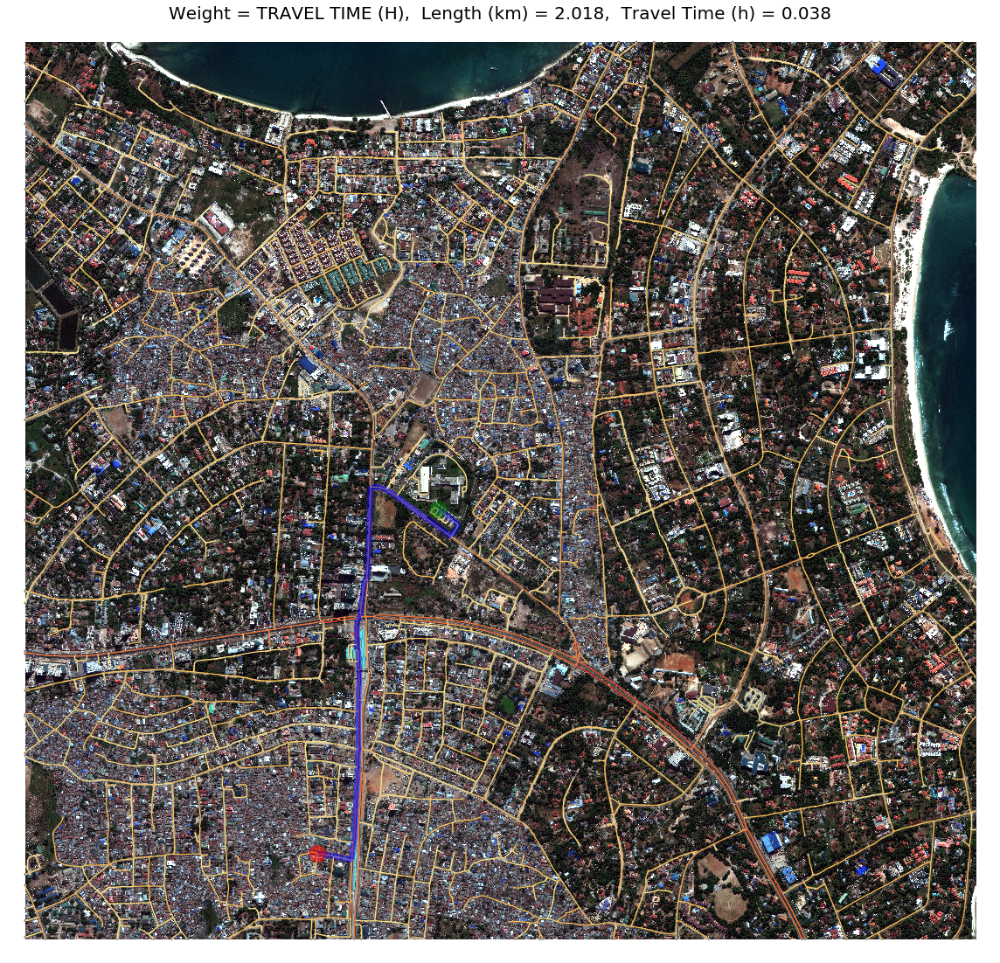

In [50]:
# Plot of optimal route between two random nodes
weight2 = 'Travel Time (h)'  # 'length'
save_plot = False  # saving is rather slow

# get random lat, lon start and end positions
lat_vals = np.random.uniform(low=-6.7880, high=-6.7580, size=(2))
lon_vals = np.random.uniform(low=39.25252, high=39.28430, size=(2))
start_pos = [lat_vals[0], lon_vals[0]]
end_pos = [lat_vals[1], lon_vals[1]]

# get nodes nearest positions
n_start = all_nodes[kdtree_nodes.query(start_pos)[1]]
n_end = all_nodes[kdtree_nodes.query(end_pos)[1]]
print("Start node: {}, End node: {}".format(n_start, n_end))

print("Weight:", weight2)
_, path2 = nx.single_source_dijkstra(G, source=n_start, target=n_end, weight=weight2)
path_coords = np.array([[G.node[t]['lat'], G.node[t]['lon']] for t in path2])
print("Optimal path:\n", path1)
print("Optimal path coordinates:\n", path_coords)
length_km2 = sum([G[path2[i]][path2[i+1]][0]['length'] for i in range(len(path2)-1)])/1000
tt2 = sum([G[path2[i]][path2[i+1]][0]['Travel Time (h)'] for i in range(len(path2)-1)])
print("Length (km):", length_km2)
print("Travel Time (h)", tt2)

if save_plot:
    fout = os.path.join(results_dir, 'plots/route_asset_time.png')  
else: 
    fout = ''

# plot speed
plt.close()
fig2, ax2 = plot_graph_plus_im.plot_graph_route_pix(G, path2, im=im_test, fig_height=fig_height, fig_width=fig_width, 
                      node_size=node_size, node_alpha=node_alpha, node_color=node_color, 
                      edge_linewidth=edge_linewidth, edge_alpha=edge_alpha, edge_color=edge_color,
                      orig_dest_node_size=orig_dest_node_size,
                      route_color=route_color, 
                      orig_dest_node_color=orig_dest_node_color,
                      route_linewidth=route_linewidth,
                      invert_yaxis=invert_yaxis, 
                      default_dpi=dpi,                        
                      show=True, close=False,
                      edge_color_key=edge_color_key,
                      color_dict=color_dict,
                      save=save_plot, filename=fout)
_ = ax2.set_title("Weight = {},  Length (km) = {},  Travel Time (h) = {}".format(
    weight2.upper(), np.round(length_km2, 3), np.round(tt2, 3)), fontsize=20)
plt.tight_layout()
plt.show()

----
### Conclusion

In this tutorial we have shown how to extract a road network graph with speed / travel time estimates direclty from satellite imagery using only open source data and code.  Inference is relatively rapid, running at 0.7 square kilometers per minute even on a CPU.  GPU infrence times would be a minimum of 20X faster.  Even for a city unseen during training (Dar Es Salaam), the CRESI algorithm manages to return a road network that is sufficiently connected and complete to be routable.  We showed how to compute optimal routes, and demonstrated the importance of routing using speed versus geometric distance.  We encourage interested parties to explore new testing regions, dive deeper into the intricacies of road network extraction and routing, and to contribute to open source geospatial software if time and interest permits.  